<a href="https://colab.research.google.com/github/pinballsurgeon/deluxo_adjacency/blob/main/Davinici_dual.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# divinci 3 review
### early baselining platform



In [8]:
### Generailzed promp prefix, modify/expand accordingly
generalized_list_request = "Return a comma seperated list of short terms representing important topics, people and technologies related to "
generalized_prompt = "Return deep details on the history, challenges, notable figures, and current day progress regarding "
generalized_analogy_quality_prompt = " return a single number between 1 and 10 rating the accuracy of this analogy "

### Crowd Source - Analogy judging panel - judge an analogy from each of thes perspectives
perspectives = ['Child', 'Scientist', 'Layperson', 'Poet', 'Politician', 'Critical Professor', 'Literary Critic', 'Federal Judge', 'Small Town Sheriff']
# perspectives = ['Child', 'Scientist']

### Analogies ( ie. 'dog is to cat' is re[presented as {'dog': 'cat'}  )
analogy_sets = {'hardware': 'software'
               ,'costs': 'progress'
               ,'classical': 'quantum'
               ,'history': 'foundation'
               ,'computer': 'cloud'
               ,'computer': 'brain'
               ,'current': 'water'
               ,'hot': 'cold'
               ,'google': 'cloud'}


analogy_combination_space = 200


# prompt_topics = ['Fusion', 'XGBoost', 'CPR', 'Molecular Spectroscopy', 'Quantum Circuits']
prompt_topics = {'Supercomputing': 0.15
                ,'Machine Learning': 0.56
                ,'Quantum Computing': 0.76
                ,'Driver-less cars': 0.66
                ,'Cloud computing': 0.22
                ,'Computer Chips': 0.88
                ,'Distributed Computing': 0.30
                ,'Augmented Reality': 0.4
                 }

### maximum number of words to keep
max_vocab_size = 50000

### gpt3 parameters (0.7, 0.2, -0.5 parameters found to be best in comparable experiment, definitely test others)
response_length_param = 2000
temperature_param = .7            
frequency_penalty_param = 0.2
presence_penalty_param = -0.5


### GPT-3 engines
gpt3_engines = {'text-davinci-002':'o'
               ,'text-davinci-003':'s'
               }


        

## Installs

In [62]:
# install openai
!pip install openai

# lda visual
!pip install pyLDAvis

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Imports

In [84]:
# gpt3 
import openai

# supply openai api key via file (a file uploaded simply containing your OpenAI token)
openai.api_key = open('openai_key').read()

# engineering
import pandas
import matplotlib.pyplot
import seaborn
import numpy
import re
import os
import time
import statistics

# tensorflow
import tensorflow
from tensorboard.plugins import projector

# scikit
from sklearn.model_selection import train_test_split
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# gensim
!pip install --upgrade gensim
from gensim.models import Word2Vec
from gensim.models import Phrases
from gensim.models.word2vec import LineSentence
from gensim.corpora import Dictionary, MmCorpus
from gensim.models.ldamulticore import LdaMulticore
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis.sklearn

# nltk
import nltk
nltk.download('punkt')
nltk.download('stopwords')




Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

## Helper functions

In [11]:
### OPENAI - Ask Davinci - build openai completion request, define parameters
def get_openai_response(question, response_length, engine):

    # format open au request
    response = openai.Completion.create(
                      engine=engine,
                      prompt=question,
                      temperature=temperature_param,
                      max_tokens=response_length,
                      top_p=1,
                      frequency_penalty=frequency_penalty_param,
                      presence_penalty=presence_penalty_param )

    # parse and process open ai response
    response_choices = response["choices"]

    # replace blanks
    response = response_choices[0]["text"].strip()

    return response

In [12]:
def vectorize_text(tokens):

  # turn tokens into vector space
  model = Word2Vec(tokens,vector_size=50,sg=1,min_count=1)

  # get list
  words=list(model.wv.index_to_key)

  materialized_model=model.wv[model.wv.index_to_key]
  df_materialized_model =pandas.DataFrame(materialized_model)

  return model, df_materialized_model, materialized_model

In [13]:
## correlation matrix, return new feature projection based on eigen vector compoents that mest explain variance
def correlation_matrix(df, materialized_model):
  
  #Computing the correlation matrix
  X_corr=df.corr()

  #Computing eigen values and eigen vectors
  values,vectors=numpy.linalg.eig(X_corr)

  #Sorting the eigen vectors coresponding to eigen values in descending order
  args = (-values).argsort()
  values = vectors[args]
  vectors = vectors[:, args]

  #Taking first 2 components which explain maximum variance for projecting
  new_vectors=vectors[:,:2]

  #Projecting it onto new dimesion with 2 axis
  neww_X=numpy.dot(materialized_model, new_vectors)

  return neww_X

In [14]:
def generate_list_of_subtopics(topic, engine):
  openai_response = get_openai_response(generalized_list_request + topic, response_length_param, engine) 
  text=re.sub(r"[^,.A-Za-z]",' ', openai_response)
  text=text.replace(',','88')
  text_arr=text.split(' ')
  text_arr=[w.lower() for w in text_arr if w.lower() not in stopwords]

  text = ' '.join(text_arr)
  sentence = re.split(r',|-|88|  ', text)
  sentence=[w.strip() for w in sentence]

  return sentence

In [15]:
def que_get_openai_response(question, response_length, engine):

  for _ in range(3):
      try:
        response = get_openai_response(question, response_length, engine)
      except:
          time.sleep(5)
          continue
      else:
          break
  else:
      response = 'GPT3 QUERY FAIL'

  return response

In [16]:
# Creating a case-specific function to avoid code repetition
def plot_hor_vs_vert(subplot, df, x, y, xlabel, ylabel, rotation,
                     tick_bottom, tick_left):
    ax=matplotlib.pyplot.subplot(1,2,subplot)
    seaborn.barplot(x, y, data=df.sort_values('value', ascending=False), hue='metric')
    matplotlib.pyplot.title(' '.join(df_responses['Engine'].unique()) + ' - Top generated analogies  ', fontsize=25)
    matplotlib.pyplot.xlabel(xlabel, fontsize=20)
    matplotlib.pyplot.xticks(fontsize=15, rotation=rotation)
    matplotlib.pyplot.ylabel(ylabel, fontsize=20)
    matplotlib.pyplot.yticks(fontsize=15)
    seaborn.despine(bottom=False, left=True)
    ax.grid(False)
    ax.tick_params(bottom=tick_bottom, left=tick_left)
    return None

### Testing helper functions

In [21]:
# test embedding space for most 
def collect_analogies(model, full_vocab, main_set, target_set):
  
  buf_int = 0
  buf_lst = []

  # reduce combiantion space to only those in proximaty to sets
  buf_sub_lst = []

  for topic, strength in model.wv.most_similar(positive=[main_set], negative=[target_set],topn=analogy_combination_space, restrict_vocab=3000):
    buf_sub_lst.append(topic)

  for topic, strength in model.wv.most_similar(positive=[target_set], negative=[main_set],topn=analogy_combination_space, restrict_vocab=3000):
    buf_sub_lst.append(topic)

  vocab = buf_sub_lst

  run_len = len(vocab) * len(vocab)
  # combinations of analogy operators
  for target_operator in vocab:
    for main_operator in vocab:

      # build candidate data model
      candidate = model.wv.most_similar(positive=[main_set, target_operator], negative=[main_operator])[0]
      candidate_target = candidate[0]
      candidate_strength = candidate[1]

      # protect against leakage
      if ((candidate_target == target_set)
      and (main_set != target_set)
      and (main_set != target_operator)
      and (main_set != main_operator)
      and (target_set != target_operator)
      and (target_set != main_operator)):

        # build results
        buf_lst.append([main_operator, main_set, target_operator
                      , target_set, candidate_strength, main_operator + ' is to ' + main_set + ' as ' + target_operator + ' is to ' + target_set])
        
        buf_int += 1

        if buf_int % 10000:
          print('%d token combination scans, %d relationships mapped %f ' % (buf_int, len(buf_lst), round((buf_int/run_len) * 100,3)))

  # form response structure
  df = pandas.DataFrame(buf_lst)
  df = df.rename(columns=dict(zip(df.columns,['main_operator', 'main_set', 'target_operator', 'target_set', 'candidate_strength', 'analogy'])))
  df = df.drop_duplicates()

  return df.sort_values(by=['candidate_strength'], ascending=False)

In [22]:
def prompt_for_analogy_rating(analogy, perspective):
  resp = que_get_openai_response('From the perspectve a ' + perspective + ', ' + generalized_analogy_quality_prompt + '"' + analogy + '"' , 4, 'text-davinci-003')
  resp = re.findall(r'\d+', resp)
  resp = int(str(resp[0])[:1])

  return resp

In [23]:
### use ai generated crowd source for rating the effectiveness of an analogy
def analogy_crowd_rating(df, perspectives):
  buf_lst_rating = []
  buf_lst_variation = []
  buf_lst_custom_rating_factor = []

  for analogy in df['analogy']:

    buf_lst_sub = []
    for perspective in perspectives:
      
      # clean rating
      rating_clean = False

      # try once
      try:
        rating = prompt_for_analogy_rating(analogy, perspective)
        rating_clean = True
      except:

        # try again 
        try:
          rating = prompt_for_analogy_rating(analogy, perspective)
          rating_clean = True
        except:
          rating = 3
          rating_clean = False
      if rating_clean:   
        buf_lst_sub.append(rating)

    # collect stats
    try:
      buf_lst_rating.append(statistics.mean(buf_lst_sub))
      buf_lst_variation.append(statistics.stdev(buf_lst_sub))
      buf_lst_custom_rating_factor.append(statistics.mean([statistics.mean(buf_lst_sub),min(buf_lst_sub)]))
    except:
      pass  

  df['gpt3_rating_mean'] = buf_lst_rating
  df['gpt3_error'] = buf_lst_variation
  df['gpt3_rating_adj'] = buf_lst_custom_rating_factor

  return df

### Runtime Buffers

In [20]:
df_responses_store = pandas.DataFrame()
lst_responses = []
run_count = 0

# regex remove all non-alpha
regex = re.compile('[^a-zA-Z]')

stopwords = nltk.corpus.stopwords.words('english')

## Prompts

In [14]:
# iterate through combinations of prompts, sub-topics and engines
for engine in gpt3_engines.keys():
  for prompt_topic in prompt_topics.keys():
    for sub_topic in generate_list_of_subtopics(prompt_topic, engine):

      # increment
      run_count += 1

      # map colors
      prompt_color = prompt_topics[prompt_topic]

      # start clock
      t0 = time.time()

      # perform query
      if len(sub_topic) < 30:
        openai_response = que_get_openai_response('From the perspective of ' + prompt_topic + '. ' + generalized_prompt + sub_topic, response_length_param, engine)

      # capture response 
      lst_responses.append([run_count                            # run number
                            , prompt_topic                       # prompt topic
                            , prompt_color                       # topic display color (matplot) 
                            , sub_topic                          # generated subtopic
                            , engine                             # engine
                            , gpt3_engines[engine]               # engine display shape (matplot) 
                            , openai_response                    # generated response
                            , len(openai_response)               # response length    
                            , len(openai_response.split(' '))    # token count
                            , int((time.time() - t0) * 1000)     # query run time
                            ])

      print('%s processed %s - %s query. resulting in %d tokens returned' % (engine, prompt_topic, sub_topic, int((time.time() - t0) * 1000)) )

# store responses in dataframe
df_responses_store = pandas.DataFrame(lst_responses, columns=['Experiment', 'Prompt', 'Prompt_Color', 'Sub_Topic', 'Engine'
                                                            , 'Engine_Shape', 'Response', 'Response_Length', 'Response_Token_Count','querytime_ms'])

# off line copy just in case
df_responses = df_responses_store


text-davinci-002 processed Supercomputing - hpc query. resulting in 6559 tokens returned
text-davinci-002 processed Supercomputing - computer architecture query. resulting in 20613 tokens returned
text-davinci-002 processed Supercomputing - simulation query. resulting in 15912 tokens returned
text-davinci-002 processed Supercomputing - visualization query. resulting in 5535 tokens returned
text-davinci-002 processed Supercomputing - data analysis query. resulting in 7717 tokens returned
text-davinci-002 processed Supercomputing - data mining query. resulting in 7534 tokens returned
text-davinci-002 processed Supercomputing - machine learning query. resulting in 1672 tokens returned
text-davinci-002 processed Supercomputing - deep learning query. resulting in 14052 tokens returned
text-davinci-002 processed Supercomputing - big data query. resulting in 3903 tokens returned
text-davinci-002 processed Supercomputing - artificial intelligence query. resulting in 7784 tokens returned
text-d

In [15]:
df_responses_backup = df_responses

In [23]:
df_responses = df_responses_backup

In [17]:
df_responses.to_csv('backup.csv', index=True)

AttributeError: ignored

In [26]:
df_responses = pandas.read_csv('backup.csv')

In [2]:
# df_responses = df_responses[df_responses['Engine']=='text-davinci-002']

NameError: ignored

In [29]:
df_responses.loc[100, 'Response']
df_responses.loc[100, 'Engine']

'text-davinci-003'

In [30]:
print(df_responses[['Prompt','Sub_Topic']].value_counts())

Prompt                 Sub_Topic              
Driver-less cars       machine learning           2
Distributed Computing  mapreduce                  2
Cloud computing        openstack                  2
                       iaas                       2
Machine Learning       support vector machines    2
                                                 ..
Distributed Computing  google cloud platform      1
                       docker                     1
                       distributed computing      1
                       cloud computing            1
Supercomputing         visualization              1
Length: 131, dtype: int64


## Analyze responses

### Similarity analysis

In [31]:
# calculate similarity between token sets

response_register = {}
tokens_full = []

for index, row in df_responses.iterrows():
    text=re.sub(r"[^.A-Za-z]",' ', row['Response'])
    text_arr=text.split(' ')
    text_arr=[w.lower() for w in text_arr if w.lower() not in stopwords]
    text = ' '.join(text_arr)
    sentence=text.split('.')
    tokens=[nltk.word_tokenize(words) for words in sentence]

    for token in tokens:
      tokens_full.append(token)

    model, df_materialized_model, materialized_model = vectorize_text(tokens)

    neww_X = correlation_matrix(df_materialized_model, materialized_model )

    response_instance = {}
    response_instance['model'] = model
    response_instance['projection'] = neww_X
    response_instance['prompt'] = row['Prompt']
    response_instance['sub_topic'] = row['Sub_Topic']

    response_register[index] = response_instance


/usr/local/lib/python3.8/dist-packages/matplotlib/collections.py:153: ComplexWarning: Casting complex values to real discards the imaginary part
  offsets = np.asanyarray(offsets, float)
<ipython-input-32-cf18558646ab>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  matplotlib.pyplot.figure(figsize=(13,7))
/usr/local/lib/python3.8/dist-packages/matplotlib/text.py:1769: ComplexWarning: Casting complex values to real discards the imaginary part
  x = float(self.convert_xunits(x))
/usr/local/lib/python3.8/dist-packages/matplotlib/text.py:1771: ComplexWarning: Casting complex values to real discards the imaginary part
  y = float(self.convert_yunits(y))
/usr/local/lib/python3.8/dist-packages/matplotlib/text.py:828: ComplexWarning: Casting complex values to real disca

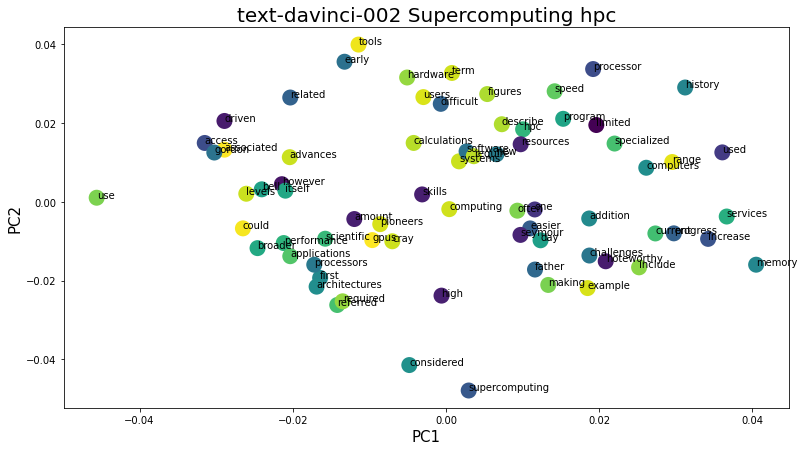

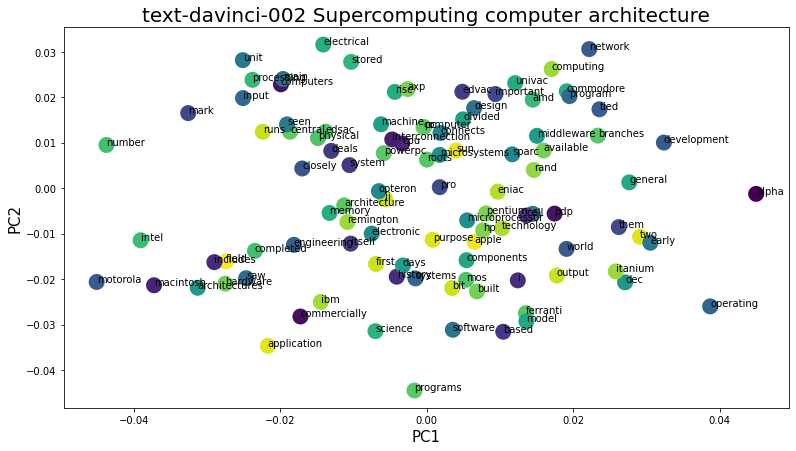

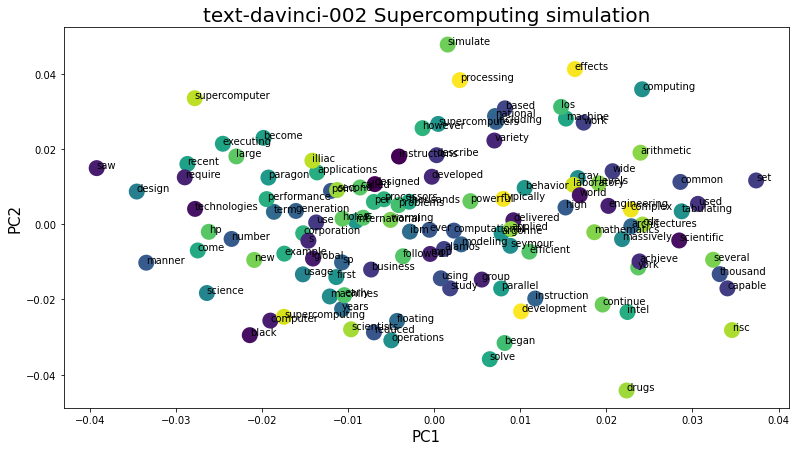

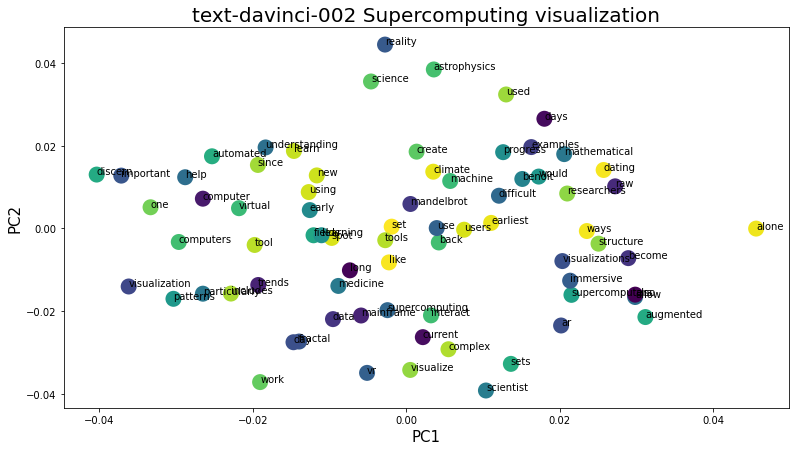

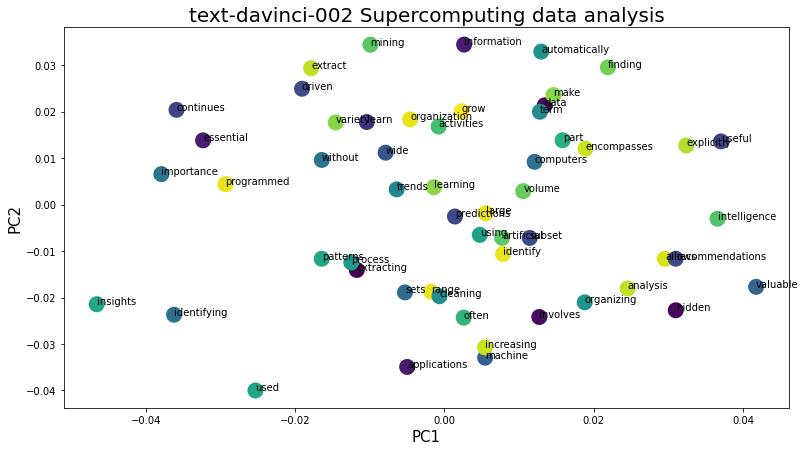

...

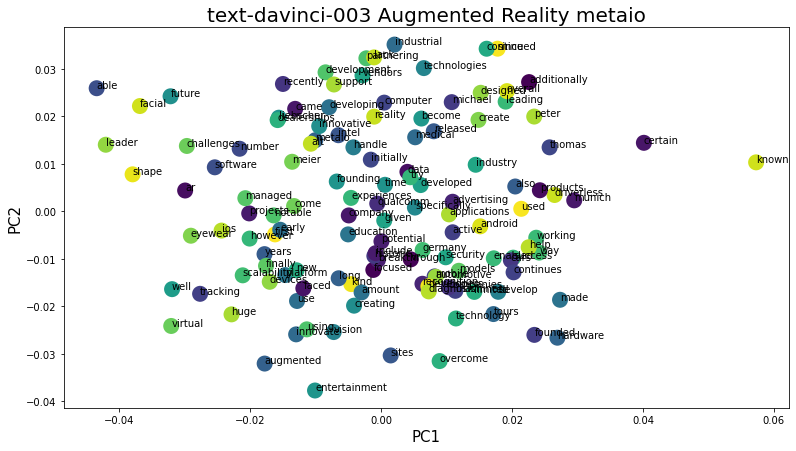

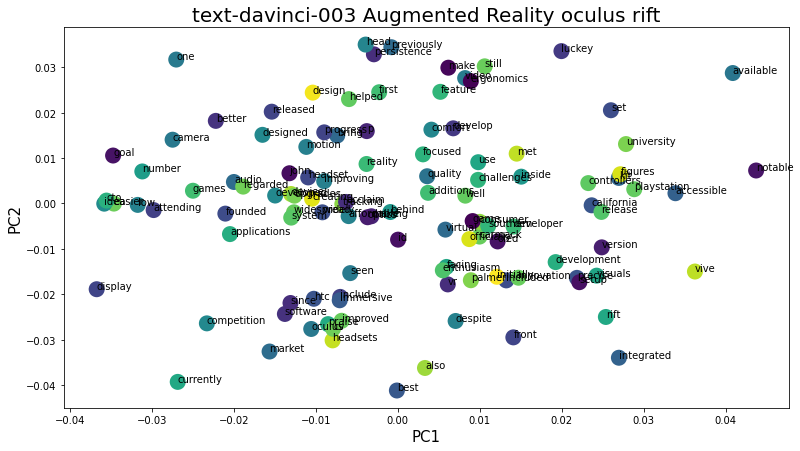

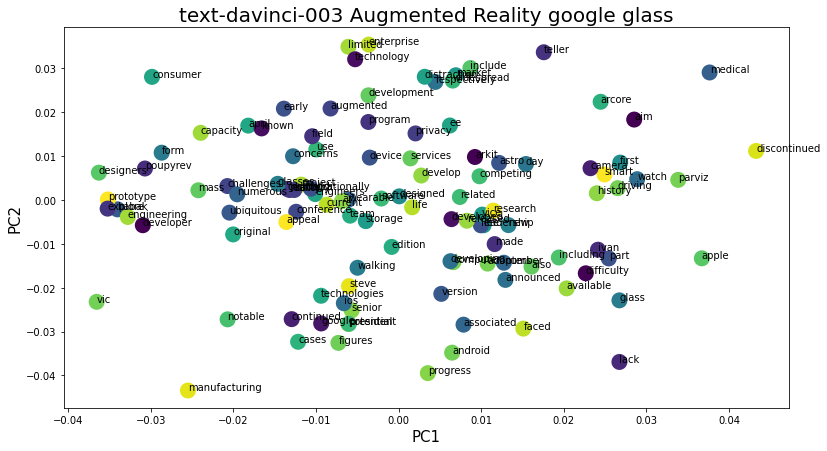

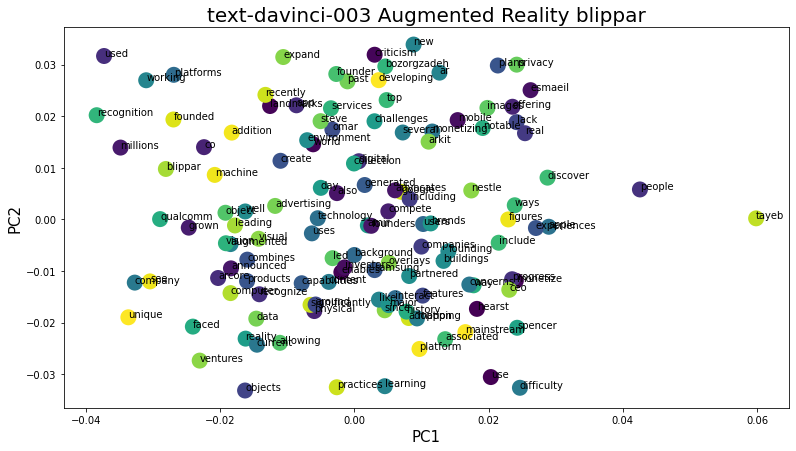

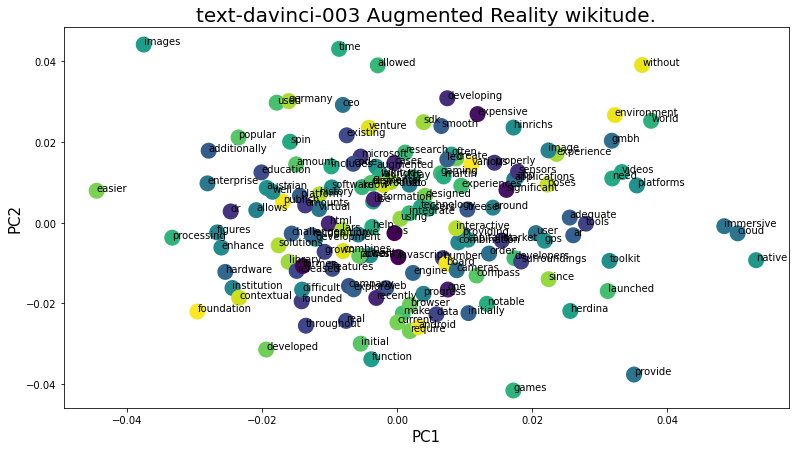

In [32]:
# display embedding spaces of each prompt response
full_vocab = []

for response_instance in list(df_responses.index):

  engine = df_responses.loc[response_instance, 'Engine']
  prompt = response_register[response_instance]['prompt']
  sub_topic = response_register[response_instance]['sub_topic']

  # some gpt3 subtopics can get messy (ig. integers)
  try:

    df_responses.loc[response_instance, 'Engine']
    colors = numpy.random.rand(len(response_register[response_instance]['projection']))
    matplotlib.pyplot.figure(figsize=(13,7))
    matplotlib.pyplot.scatter(response_register[response_instance]['projection'][:,0],response_register[response_instance]['projection'][:,1],linewidths=10,c=colors)
    matplotlib.pyplot.xlabel("PC1",size=15)
    matplotlib.pyplot.ylabel("PC2",size=15)
    matplotlib.pyplot.title(engine + ' ' +
                            prompt + ' ' +
                            sub_topic,size=20)
    vocab=list(response_register[response_instance]['model'].wv.index_to_key)
    for i, word in enumerate(vocab):
      full_vocab.append(word)
      matplotlib.pyplot.annotate(word,xy=(response_register[response_instance]['projection'][i,0],response_register[response_instance]['projection'][i,1]))
  except:
    pass

### Analogy Testing

In [35]:
# for each given combination of analogy seed, form analogies and determine best

#full_spectrum
model, df_materialized_model, materialized_model = vectorize_text(tokens_full)
model.wv.sort_by_descending_frequency()

# for the given results, return the best fit analogies.  Uses 
analogies_df_total=pandas.DataFrame()

# for given analogy sets (narratives)
for key, value in analogy_sets.items():

  try:

    # collect analogies
    analogies_df = collect_analogies(model, full_vocab, key, value).head(3)
    
    # generate review of analgoies accuracy
    analogies_df = analogy_crowd_rating(analogies_df, perspectives)

    analogies_df_total = pandas.concat([analogies_df_total, analogies_df])

  except Exception as e:
    print(key, value, e)
    pass


Streaming output truncated to the last 5000 lines.
7747 token combination scans, 7747 relationships mapped 4.842000 
7748 token combination scans, 7748 relationships mapped 4.843000 
7749 token combination scans, 7749 relationships mapped 4.843000 
7750 token combination scans, 7750 relationships mapped 4.844000 
7751 token combination scans, 7751 relationships mapped 4.844000 
7752 token combination scans, 7752 relationships mapped 4.845000 
7753 token combination scans, 7753 relationships mapped 4.846000 
7754 token combination scans, 7754 relationships mapped 4.846000 
7755 token combination scans, 7755 relationships mapped 4.847000 
7756 token combination scans, 7756 relationships mapped 4.848000 
7757 token combination scans, 7757 relationships mapped 4.848000 
7758 token combination scans, 7758 relationships mapped 4.849000 
7759 token combination scans, 7759 relationships mapped 4.849000 
7760 token combination scans, 7760 relationships mapped 4.850000 
7761 token combination sc

In [36]:
analogies_df_total


,main_operator,main_set,target_operator,target_set,candidate_strength,analogy,gpt3_rating_mean,gpt3_error,gpt3_rating_adj
4234,lot,hardware,faced,software,0.995520,lot is to hardware as faced is to software,7.142857,0.377964,7.071429
5968,engineering,hardware,products,software,0.994196,engineering is to hardware as products is to s...,7.571429,0.786796,7.285714
4237,advancements,hardware,faced,software,0.994003,advancements is to hardware as faced is to sof...,7.250000,0.707107,7.125000
352,across,costs,current,progress,0.988882,across is to costs as current is to progress,7.000000,0.707107,6.500000
410,batch,costs,current,progress,0.988539,batch is to costs as current is to progress,7.000000,0.577350,6.500000
349,allowed,costs,current,progress,0.987525,allowed is to costs as current is to progress,7.250000,0.462910,7.125000
6700,created,classical,wave,quantum,0.993375,created is to classical as wave is to quantum,6.555556,1.424001,4.777778
2980,react,classical,theory,quantum,0.993197,react is to classical as theory is to quantum,6.750000,0.707107,5.875000
3922,physical,classical,built,quantum,0.992600,physical is to classical as built is to quantum,3.250000,1.581139,2.625000
34,quantum,computer,significantly,brain,0.991192,quantum is to computer as significantly is to ...,6.000000,1.414214,5.500000


<ipython-input-37-1fe255456145>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['value'] = df1['gpt3_rating_adj']
<ipython-input-37-1fe255456145>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['metric'] = 'gpt3_rating_adj'
<ipython-input-37-1fe255456145>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/

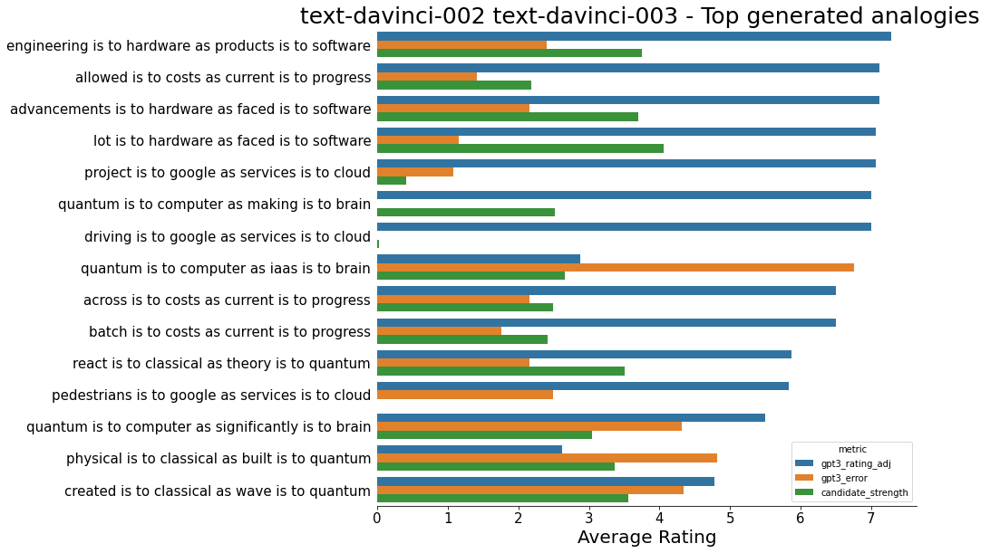

In [37]:
# reshape dataframes
df1 = analogies_df_total[['analogy', 'gpt3_rating_adj']]
df1['value'] = df1['gpt3_rating_adj']
df1['metric'] = 'gpt3_rating_adj'
df1 = df1[['analogy','value', 'metric']]

df2 = analogies_df_total[['analogy', 'candidate_strength']]
val_max = df2['candidate_strength'].max(); val_min = df2['candidate_strength'].min()
df2['candidate_strength'] = [(x-val_min)/(val_max-val_min) for x in df2['candidate_strength']]
df2['candidate_strength'] = [x * ( .07 / (val_max-val_min) ) for x in df2['candidate_strength']]
df2['value'] = df2['candidate_strength']
df2['metric'] = 'candidate_strength'
df2 = df2[['analogy','value', 'metric']]

df3 = analogies_df_total[['analogy', 'gpt3_error']]
val_max = df3['gpt3_error'].max(); val_min = df3['gpt3_error'].min()
df3['gpt3_error'] = [(x-val_min)/(val_max-val_min) for x in df3['gpt3_error']]
df3['gpt3_error'] = [x * ( 15 / (val_max-val_min) ) for x in df3['gpt3_error']]
df3['value'] = df3['gpt3_error']
df3['metric'] = 'gpt3_error'
df3 = df3[['analogy','value', 'metric']]

df = pandas.concat([df1, df2, df3])

# plot
fig, ax = matplotlib.pyplot.subplots(figsize=(20,9))
fig.tight_layout(pad=5)

plot_hor_vs_vert(2, df, x='value', y='analogy',
                  xlabel='Average Rating', ylabel=None,
                  rotation=None, tick_bottom=True, tick_left=False)
matplotlib.pyplot.show()

In [37]:
# test analogy ranking machine
buf = prompt_for_analogy_rating("horse is to kite as muffin is to elbow", 'Child')
print(buf)
buf = prompt_for_analogy_rating("hardware is to brain as software is to mind", 'Child')
print(buf)

## Topic Modeling Analysis

In [98]:
# build and fit count vectorizer
tf_vectorizer = CountVectorizer(strip_accents = 'unicode',
                                stop_words = 'english',
                                lowercase = True,
                                token_pattern = r'\b[a-zA-Z]{3,}\b',
                                max_df = 0.5, 
                                min_df = 10)

# vectorize
dtm_tf = tf_vectorizer.fit_transform(df_responses['Response_clean'].values.astype('U'))

# fit trasformer to text
tfidf_vectorizer = TfidfVectorizer(**tf_vectorizer.get_params())
dtm_tfidf = tfidf_vectorizer.fit_transform(df_responses['Response_clean'].values.astype('U')) 

# fit lda
lda_tf = LatentDirichletAllocation(n_components=10, random_state=0) 
lda_tf.fit(dtm_tf)

# visualize analysis
pyLDAvis.display(pyLDAvis.sklearn.prepare(lda_tf, dtm_tf, tf_vectorizer))

### Tensorboard Embedding Analysis

In [39]:
# establish color map per classification
num_classes = len(df_responses['Engine'].value_counts())
colors = matplotlib.pyplot.cm.Dark2(numpy.linspace(0, 1, num_classes))
iter_color = iter(colors)

In [40]:
# declare target through conditions
conditions = [
    (df_responses['Engine'] == 'text-davinci-002'),
    (df_responses['Engine'] == 'text-davinci-003')
    ]
choices = [0, 1]
df_responses['target'] = numpy.select(conditions, choices, default=0)
df_responses['target'].value_counts()


1    86
0    69
Name: target, dtype: int64

In [41]:
# target and feature test/train splits

# target (default - gpt-3 Engine type)
y = tensorflow.keras.utils.to_categorical(df_responses["target"].values, num_classes=num_classes)

# features
df_responses['Response_clean'] = [regex.sub(' ', response) for response in df_responses['Response'].fillna(' ')]
df_responses['Response_clean'] = df_responses['Response_clean'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stopwords)]))

# test/train split
x_train, x_test, y_train, y_test = train_test_split(df_responses['Response_clean'], y, test_size=0.1)

In [42]:
# tokenize content

# instance of the Tokenizer class
tokenizer = tensorflow.keras.preprocessing.text.Tokenizer(num_words=max_vocab_size)

# fit tokenizer on the train set
tokenizer.fit_on_texts(x_train)

# create numeric sequences for train and validation sets
sequences_train = tokenizer.texts_to_sequences(x_train)
sequences_test = tokenizer.texts_to_sequences(x_test)

In [43]:
# form dictionary

# dictionary -> (word: integer)
wordindex_dict = tokenizer.word_index

# number of unique words
words = len(wordindex_dict)
  

In [44]:
# craete map between a token and its source engine(s)
df= pandas.DataFrame()
lst = []
source_map = {}
for index, response in x_train.iteritems():
  for w in wordindex_dict:
    if w in response.lower():
      # print(df_responses.iloc[index]['Engine'])
      lst.append([w, df_responses.iloc[index]['Engine']])

df = pandas.DataFrame(lst, columns=['word', 'engine'])

i=0
for index, row in df.iterrows():

  df_sub1 = df[df['word'] == row['word']]

  #determine if token is mapped to multiopel engines or just one
  if len(list(df_sub1['engine'].unique())) > 1:
    source_map[row['word']] = 'Both'
  elif len(list(df_sub1['engine'].unique())) == 1:
    source_map[row['word']] = max(list(df_sub1['engine'].unique()))
  else:
    source_map[row['word']] = max(list(gpt3_engines.keys()))

  # debug mode
  i += 1
  #if i > 10:
  #  break



In [45]:
# padding of content
data_train = tensorflow.keras.preprocessing.sequence.pad_sequences(sequences_train)
sequence_length = data_train.shape[1]
data_test = tensorflow.keras.preprocessing.sequence.pad_sequences(sequences_test, maxlen=sequence_length)

print('Shape of train tensor:', data_train.shape)
print('Shape of test tensor:', data_test.shape)

Shape of train tensor: (139, 398)
Shape of test tensor: (16, 398)


In [46]:
# embedding and keras layer declaration
embedding_dimensionality = 3
hidden_state_dimensionality = 60

i = tensorflow.keras.layers.Input(shape=(sequence_length,))
x = tensorflow.keras.layers.Embedding(words+1, embedding_dimensionality)(i)
x = tensorflow.keras.layers.Dropout(0.3)(x)
x = tensorflow.keras.layers.Dense(100)(x)
x = tensorflow.keras.layers.Dropout(0.3)(x)
x = tensorflow.keras.layers.GlobalMaxPooling1D()(x)
x = tensorflow.keras.layers.Dense(num_classes, activation='softmax')(x)

model = tensorflow.keras.models.Model(i, x)

In [47]:
# early stop call back if training progress ends
earlystop_callback = tensorflow.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                      patience=10, 
                                                      restore_best_weights=True)

# metric to report learning history
METRICS = [  
      tensorflow.keras.metrics.CategoricalAccuracy(name="accuracy")  
]

# model compiling
model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=METRICS
)

# fit to training
model_fit=model.fit(
  data_train,
  y_train,
  epochs=50,
  validation_data=(data_test, y_test),
  callbacks=[earlystop_callback]
)

Epoch 1/50
5/5 [==============================] - 3s 50ms/step - loss: 0.6894 - accuracy: 0.5396 - val_loss: 0.6799 - val_accuracy: 0.6875
Epoch 2/50
5/5 [==============================] - 0s 9ms/step - loss: 0.6876 - accuracy: 0.5396 - val_loss: 0.6721 - val_accuracy: 0.6875
Epoch 3/50
5/5 [==============================] - 0s 9ms/step - loss: 0.6858 - accuracy: 0.5396 - val_loss: 0.6669 - val_accuracy: 0.6875
Epoch 4/50
5/5 [==============================] - 0s 9ms/step - loss: 0.6852 - accuracy: 0.5396 - val_loss: 0.6626 - val_accuracy: 0.6875
Epoch 5/50
5/5 [==============================] - 0s 9ms/step - loss: 0.6839 - accuracy: 0.5396 - val_loss: 0.6623 - val_accuracy: 0.6875
Epoch 6/50
5/5 [==============================] - 0s 9ms/step - loss: 0.6821 - accuracy: 0.5396 - val_loss: 0.6605 - val_accuracy: 0.6875
Epoch 7/50
5/5 [==============================] - 0s 8ms/step - loss: 0.6809 - accuracy: 0.5396 - val_loss: 0.6611 - val_accuracy: 0.6875
Epoch 8/50
5/5 [=================

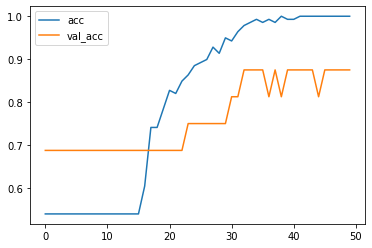

In [48]:
# plot model learning charecteristics
matplotlib.pyplot.plot(model_fit.history['accuracy'], label='acc')
matplotlib.pyplot.plot(model_fit.history['val_accuracy'], label='val_acc')
matplotlib.pyplot.legend()

In [50]:
# create tensor board metadata, log and checkpoints

# create logging directory
log_dir='/logs/fit/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

# write wordindex dictionary
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  f.write("'Word\tEngine\n")
  for w in wordindex_dict:
    #f.write("{}\n".format(w))
    f.write("%s\t%s\n" % (w, source_map[w]))

# weights from the embedding layer, in our case: model.layers[1]
weights_arr = [x*1 for x in model.layers[1].get_weights()[0][1:]]
weights = tensorflow.Variable(weights_arr)
checkpoint = tensorflow.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# configuration set-up
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

In [51]:
%reload_ext tensorboard
%tensorboard --logdir /logs/fit/

<IPython.core.display.Javascript object>